In [1]:
import sys
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
%%capture --no-display
%load_ext autoreload
%autoreload 2

project_root = Path.cwd().parent

if str(project_root) not in sys.path:
    sys.path.append(str(project_root))
from weedcrop.autofarm import *

print(f"Successfully imported from: {project_root / 'weedcrop'}")

<div align="center">

# Autofarming
## Surgical Weed Control via Multi-modal Feature Fusion

<br>

**Student:** Ioannis Petrousov  
**Email:** [contact@petrousoft.com](mailto:contact@petrousoft.com)  

<br>

**MSc in Artificial Intelligence**  
**Course:** Machine Learning  
**Date:** February 2026

<br>
<br>

| | |
|:---:|:---:|
| <img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSSFd6A0n_C6Wb_JrgfkI0GioEeeCFArki1-g&s" width="200"/> | <img src="https://upload.wikimedia.org/wikipedia/en/thumb/a/a4/UNIPI_Emblem.png/250px-UNIPI_Emblem.png" width="200"/> |
| **NCSR Demokritos** | **University of Piraeus** |

<br>

---

</div>

<div align="center">
    <h1>Motivation</h1>
    <img src="https://preview.redd.it/ad5iframit841.jpg?width=640&crop=smart&auto=webp&s=2bab3a9a58d06760acd84202ca95ec3ce2eef50f" width="1000" alt="Interstellar Autonomous Combine"/>
    <p><i>Fiction: GPS-guided autonomous combine in Interstellar (2014).</i></p> 
</div>

Vision: 100% autonomous labor.

Scale: Entire landscapes managed by robots.

The Magic of Hollywood: The movie skips the hardest part—how the machine sees the **difference between a crop and a weed**.

- Interstellar (2014)
- Autonomous farming machines manage vast fields without human intervention
- A high-tech necessity for a dying world.

<div align="center">
    <h1>From fiction to reality</h1>
    <img src="https://www.naio-technologies.com/wp-content/uploads/2021/03/dino-tien-tran-hans-lucas-hd-3-2.jpg" width="800" alt="Autonomous weeding machine"/>
    <figcaption>Dino: Autonomous weeding machine - Naio Technologies.</figcaption>
</div>

<br>

> "By some estimates, 255 different weed species have already developed resistance in 92 crops in 70 countries. Yet, no major new herbicide mode of action has been introduced to the marketplace for almost 20 years."
> — *[Successful Farming (Agriculture.com)](https://www.agriculture.com/technology/robotics/the-future-of-robotic-weeders)*

<br>

- **Industrial Momentum:** Leading companies developing proprietary systems include **John Deere**, **AGCO**, and **Ecorobotix**.
- **Sustainability:** Drastic reduction in herbicide usage by moving away from blanket spraying to precise, individual weed targeting.
- **Labor Efficiency:** Providing a scalable solution to the critical global shortage of agricultural labor.

<div align="center">
    <h1>The challenge</h1>
    <p><i>The ML Challenge: The core of this revolution is Computer Vision—the ability for a machine to distinguish life from life (Crop vs. Weed).</i></p>
</div>


<div align="center">
    <h1>Dataset Overview & Initial Exploration</h1>
</div>

- Annotated Food Crops and Weed Images in their early seedling stages
- Locations: Latvia
- 8 weed and 6 food species
- Seedlings cultivated in controlled greenhouse conditions and open field conditions
- Camera models: Canon EOS 800D, Sony W800, Intel RealSense D435

```text
@article{SUDARS2020105833,
  title = {Dataset of annotated food crops and weed images for robotic computer vision control},
  journal = {Data in Brief},
  volume = {31},
  pages = {105833},
  year = {2020},
  issn = {2352-3409},
  doi = {https://doi.org/10.1016/j.dib.2020.105833},
  url = {https://www.sciencedirect.com/science/article/pii/S2352340920307277},
  author = {Kaspars Sudars and Janis Jasko and Ivars Namatevs and Liva Ozola and Niks Badaukis},
}
```

In [3]:
ds = create_dataset_list(ds_dir)
print_ds_info(ds)

Nof weed samples: 1116
Nof crop samples: 60
Weeds/Crops ratio: 18.6


In [4]:
print(f"Class values: {np.unique(np.array(ds)[:, 1])}")

Class values: ['crop' 'weed']


In [5]:
get_dataset_resolution_stats(ds);

Stats: {'min': (360, 360), 'max': (1280, 1000), 'avg': (1177, 704)}


As you can understand this dataset is very inconsistent.

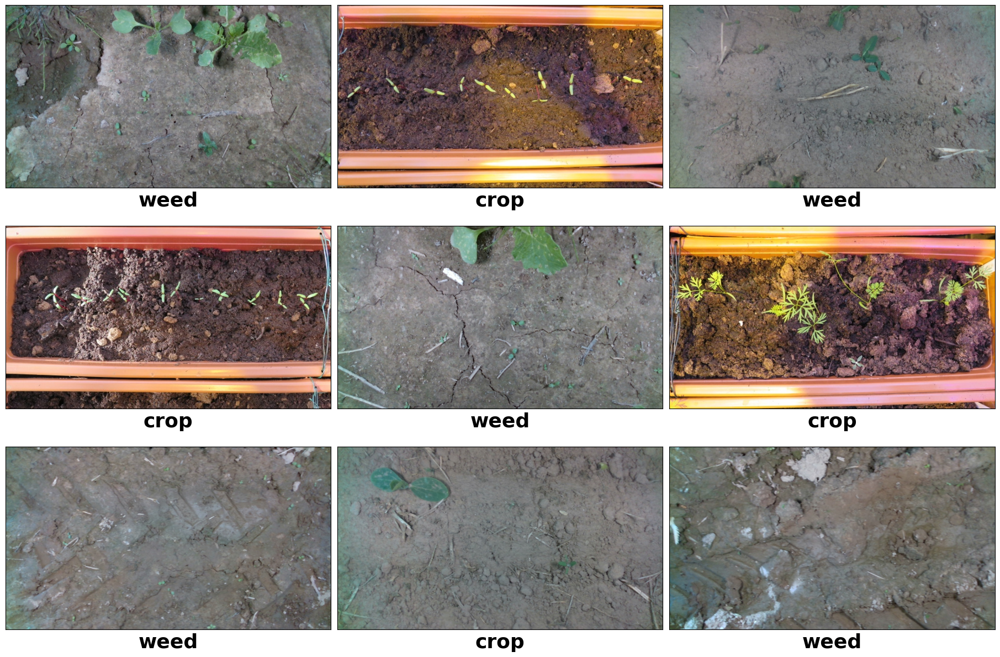

In [6]:
visualize_ds_sample(ds)

<div align="center">
    <h1>Dataset preparation</h1>
</div>

1. Create dataset path
2. Create ds list
3. Load images into memory
4. Resize to equal size - 256x256
5. Extract labels

In [7]:
%%time
X_rez, y_labels = prepare_ds_pipeline()
list(map(len, [X_rez, y_labels]))

CPU times: user 1min 2s, sys: 45.8 s, total: 1min 48s
Wall time: 2min 17s


[1176, 1176]

<div align="center">
    <h1>Feature Engineering</h1>
</div>

<div align="center">
    <h2>1. Histogram of Oriented Graphs - HOG</h2>
</div>

- Used in shape recongnition.
- HOG captures the distribution of intensity gradients - edges and shapes

```python
orientations=9,
pixels_per_cell=(8, 8),
cells_per_block=(2, 2),
```

In [8]:
%%time
X_hog_features = extract_hog_features_from_list(X_rez)

CPU times: user 17.1 s, sys: 105 ms, total: 17.2 s
Wall time: 17.2 s


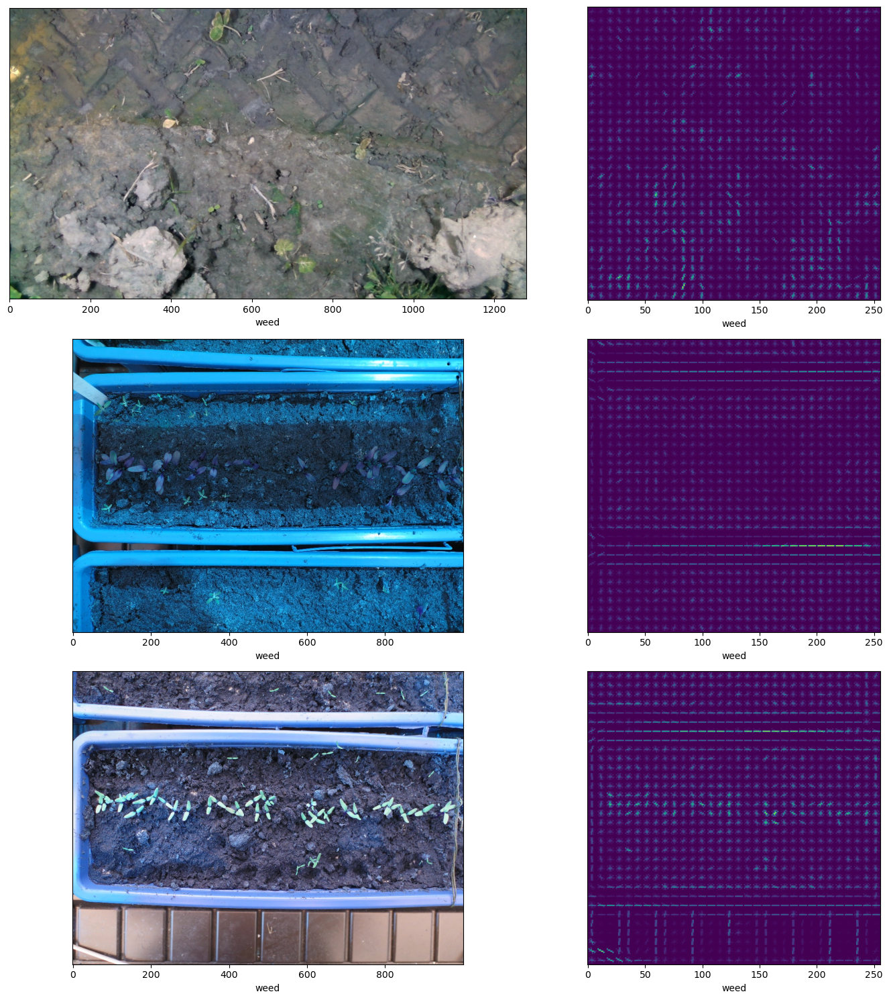

In [9]:
visualize_hog_features(ds)

<div align="center">
    <h3>HOG features per image</h3>
</div>

In [10]:
len(X_hog_features[0])

34596

The amount of HOG feature is too high for statistical models.

Can we reduce?

<div align="center">
    <h3>Reduce the amount of HOG features</h3>
</div>

- We have way too many HOG features for statistical model.
- Let's use Principal Component Analysis - PCA

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Standardize the data (Mean=0, StdDev=1)
X_hog_scaled = StandardScaler().fit_transform(X_hog_features)

# Sanity check
print(f"Mean: {round(np.mean(X_hog_scaled))}, Std. Dev: {round(np.std(X_hog_scaled))}")

# Nof initial components/features we have
print(f"Initial nof components: {len(X_hog_scaled[0])}")

# Apply PCA
pca_check = PCA(n_components=800)
pca_check.fit(X_hog_scaled)

Mean: 0, Std. Dev: 1
Initial nof components: 34596


PCA(n_components=800)

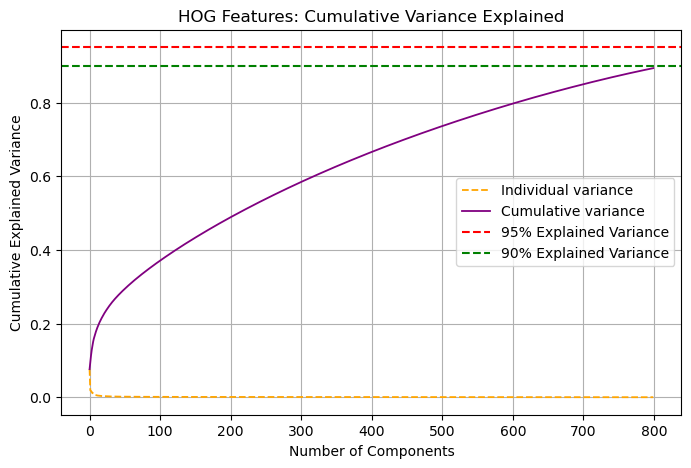

In [12]:
# Extract variance
variance_ratio = pca_check.explained_variance_ratio_
cumulative_variance = np.cumsum(variance_ratio)

# Plot the Scree Plot
plt.figure(figsize=(8, 5))
plt.plot(variance_ratio, linewidth=1.3, linestyle="--", color="orange", label="Individual variance")
plt.plot(cumulative_variance, linewidth=1.3, linestyle="-", color="purple", label="Cumulative variance")
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('HOG Features: Cumulative Variance Explained')
plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
plt.axhline(y=0.90, color='g', linestyle='--', label='90% Explained Variance')
plt.legend()
plt.grid()
plt.show()

In [13]:
pca_apply = PCA(n_components=800)
X_hog_reduced = pca_apply.fit_transform(X_hog_scaled)

<div align="center">
    <h2>2. Local Binary Pattern - LBP</h2>
</div>

- Used for texture description
- Labels pixels by comparing their intensity to their neighbors
- Creates a binary code representing local texture
- Used in face recognition, texture analysis, and object detection

In [14]:
%%time
X_lbp_features = extract_lbp_features_from_list(X_rez)
len(X_lbp_features[0])

/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/skimage/feature/texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


CPU times: user 6.89 s, sys: 0 ns, total: 6.89 s
Wall time: 6.92 s


10

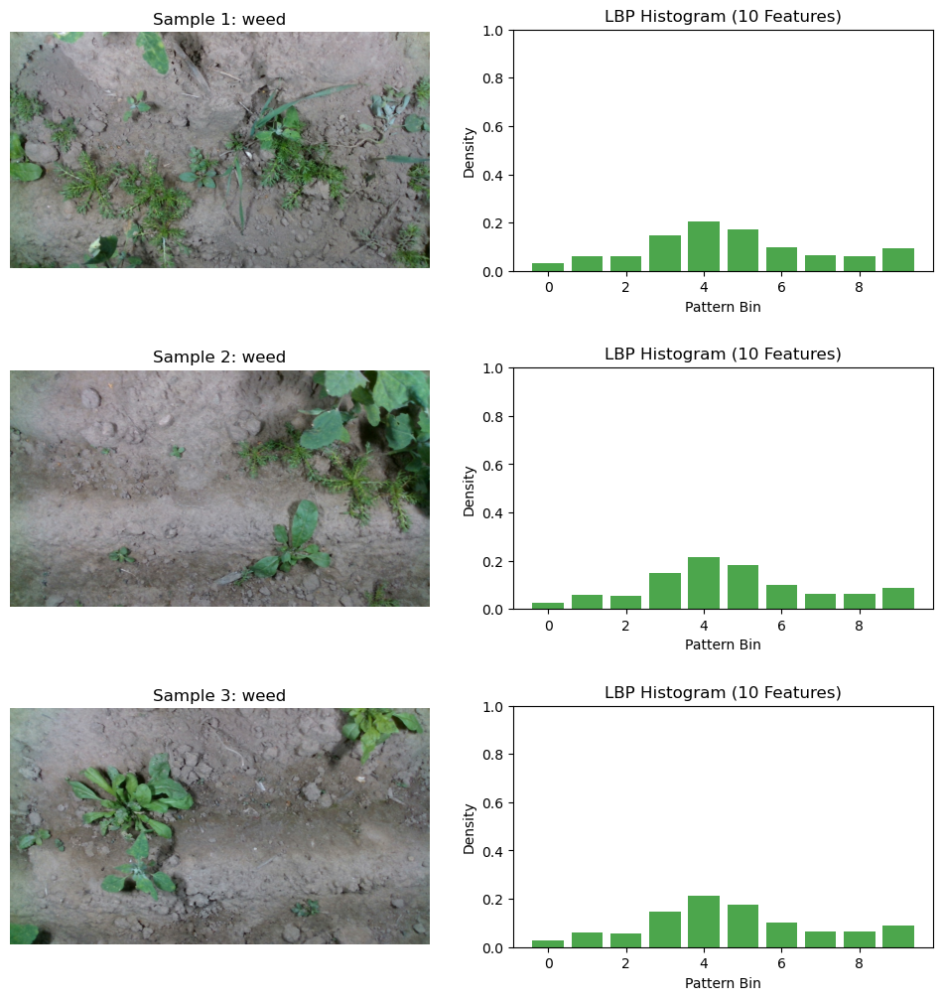

In [15]:
visualize_lbp_features(ds)

<div align="center">
    <h2>3. RGB to HSV</h2>
</div>

- Hue Saturation Value - HSV
- Useful in extracing shapes from the images - segmentation.
- Allows us to analyze the patterns in the images

**Goal**: extract the green parts (plants & weeds) from the brown/grey soil and pots.
**How**: apply filters on these channels.

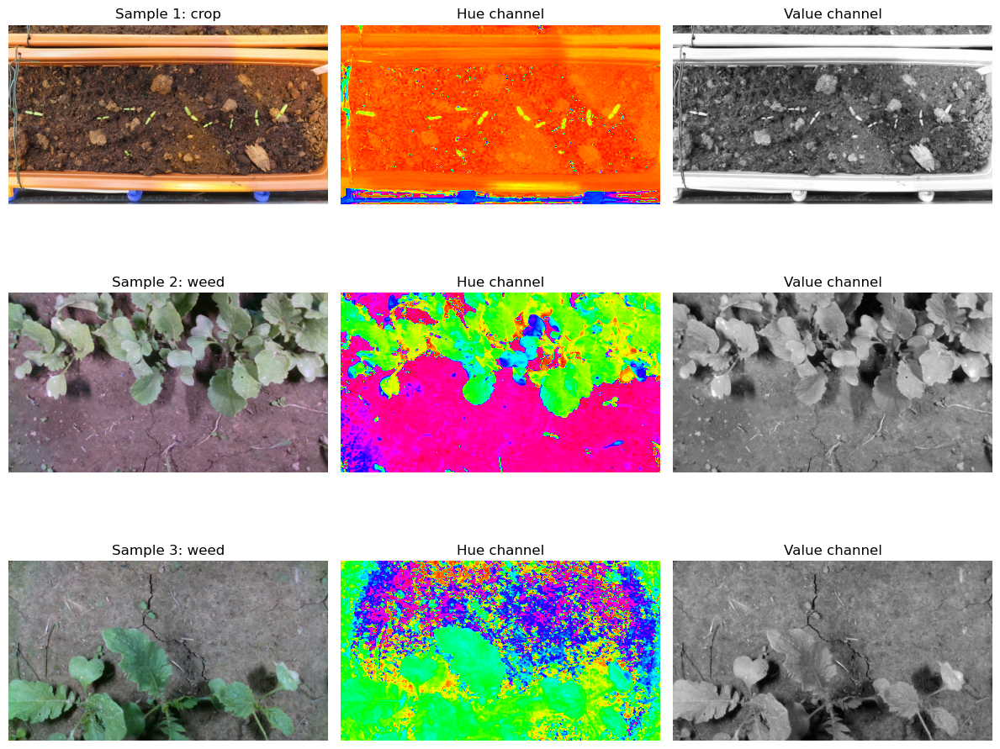

In [16]:
visualize_hsv_channels(ds)

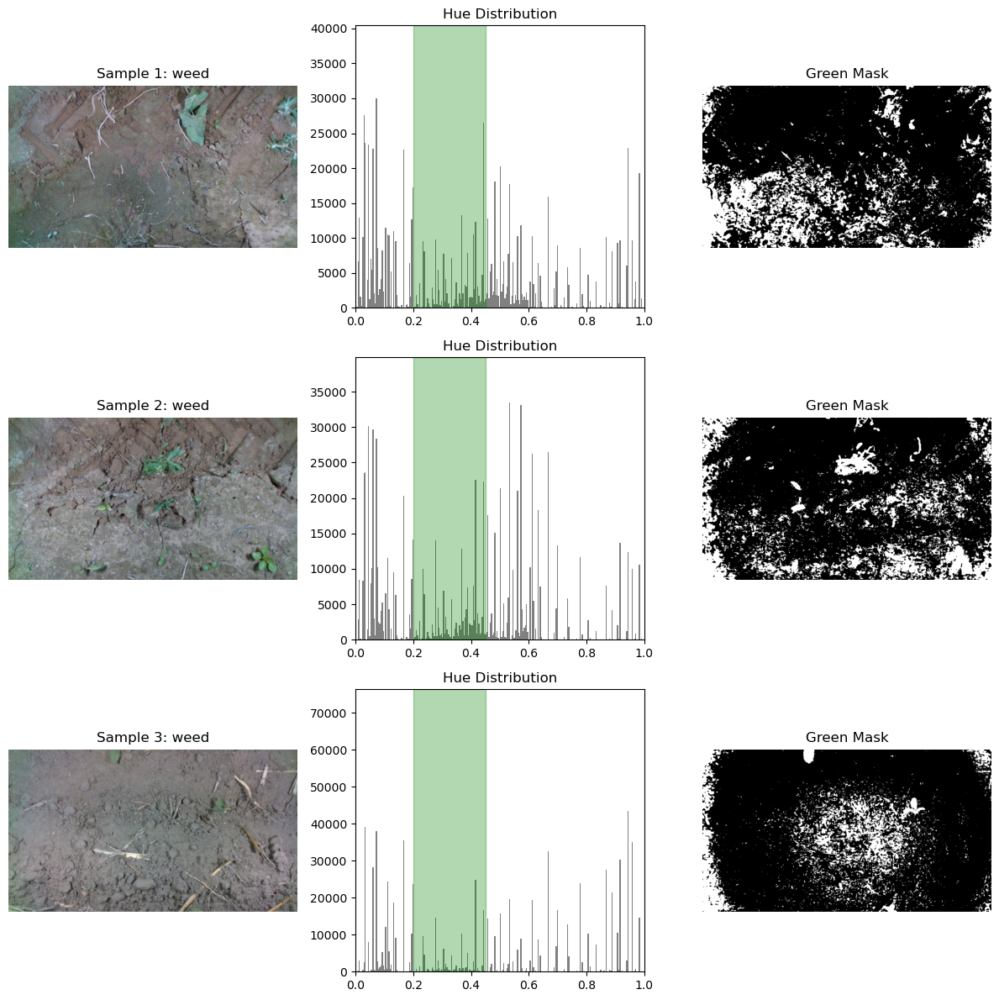

In [17]:
visualize_hue_thresholding(ds, hue_lower_bound=0.2, hue_upper_bound=0.45)

We seem to be capturing a lot of information about the plant shapes.
Can we do better?

Yes! Let's also involve the Saturation channel.

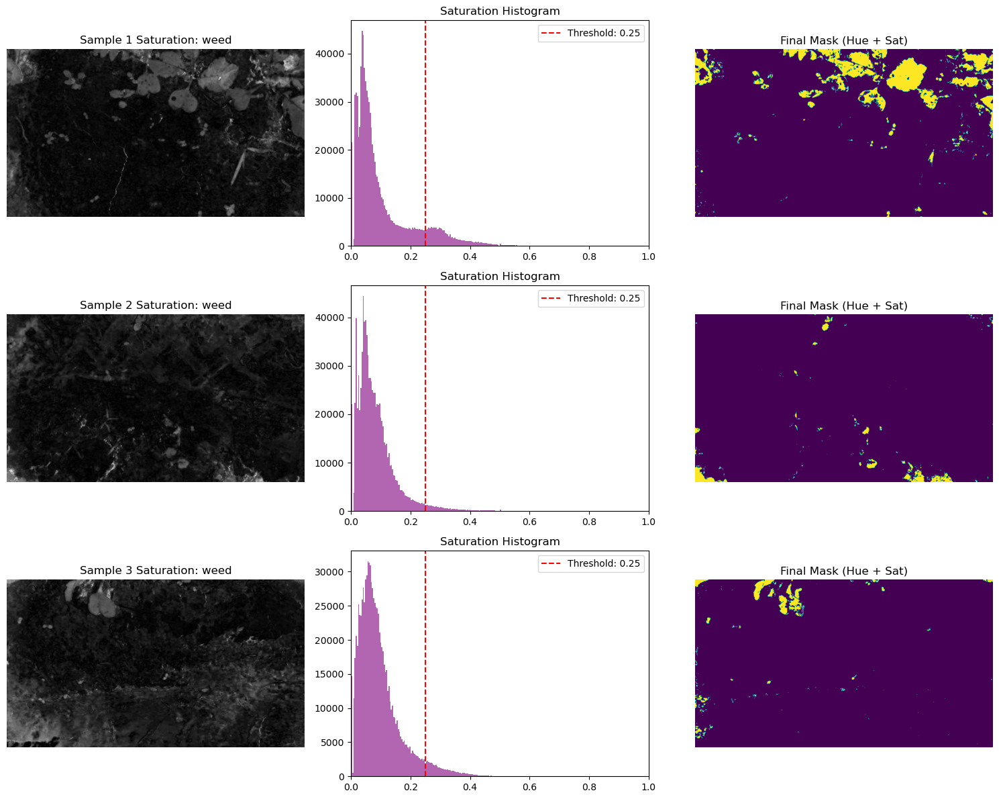

In [18]:
visualize_saturation_thresholding(ds, hue_lower_bound=0.2, hue_upper_bound=0.45, sat_lower=0.25)

In [19]:
%%time
X_hsv_features = extract_hsv_features_from_list(X_rez)

CPU times: user 11.1 s, sys: 0 ns, total: 11.1 s
Wall time: 11.1 s


In [20]:
# Default: 10 bins, 3 channels = 30
X_hsv_features.shape

(1176, 30)

<div align="center">
    <h1>Augmentations</h1>
</div>

- The dataset is highly imbalanced
- We have at least 18 `weed` images for each `crop` image

Augmentations on the `crop` samples in the `training dataset` ONLY!

Steps:

- split the dataset using `train_test_split`
- extract the `crop` images from train
- augment `crop` train images


In [21]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(
    X_rez,
    y_labels,
    train_size=0.8,
    stratify=y_labels, # Balances sets
    random_state=42
)

print(f"Lens:{len(X_train), len(X_test)}")

# Train crop indices
train_crop_indices = [ i for i, elm in enumerate(y_train) if elm == "crop" ]
print(f"Train crops: {len(train_crop_indices)}")

# Sanity check only
test_crop_indices = [ i for i, elm in enumerate(y_test) if elm == "crop" ]
print(f"Test crops: {len(test_crop_indices)}")

# Gather train crop images
train_crop_images = [ X_train[i] for i in train_crop_indices ]

Lens:(940, 236)
Train crops: 48
Test crops: 12


<div align="center">
    <h2>Augmentation pipeline</h2>
</div>

Library: https://albumentations.ai/

In [22]:
import albumentations as A
transform = A.Compose([
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=20, p=0.3),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.GaussianBlur(blur_limit=(3, 5), p=0.1),
    A.GaussNoise(std_range=(0.04, 0.2), p=0.2),
])
transform.set_random_seed(42)

/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/albumentations/core/validation.py:132: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [23]:
%%time
# Augment train crop images
train_crop_aug = [ transform(image=img.astype("float32")) for img in train_crop_images ]

CPU times: user 35.3 ms, sys: 2.7 ms, total: 38 ms
Wall time: 39.9 ms


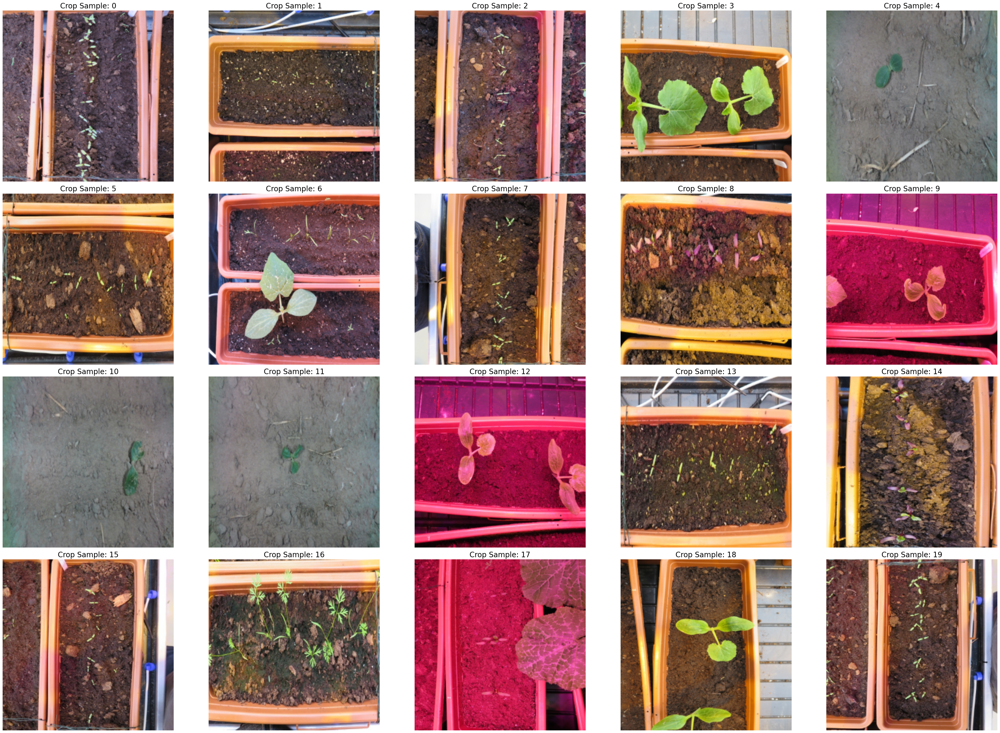

In [24]:
# Initial crop sample
visualize_crop_samples(train_crop_images, rows=4, cols=5)

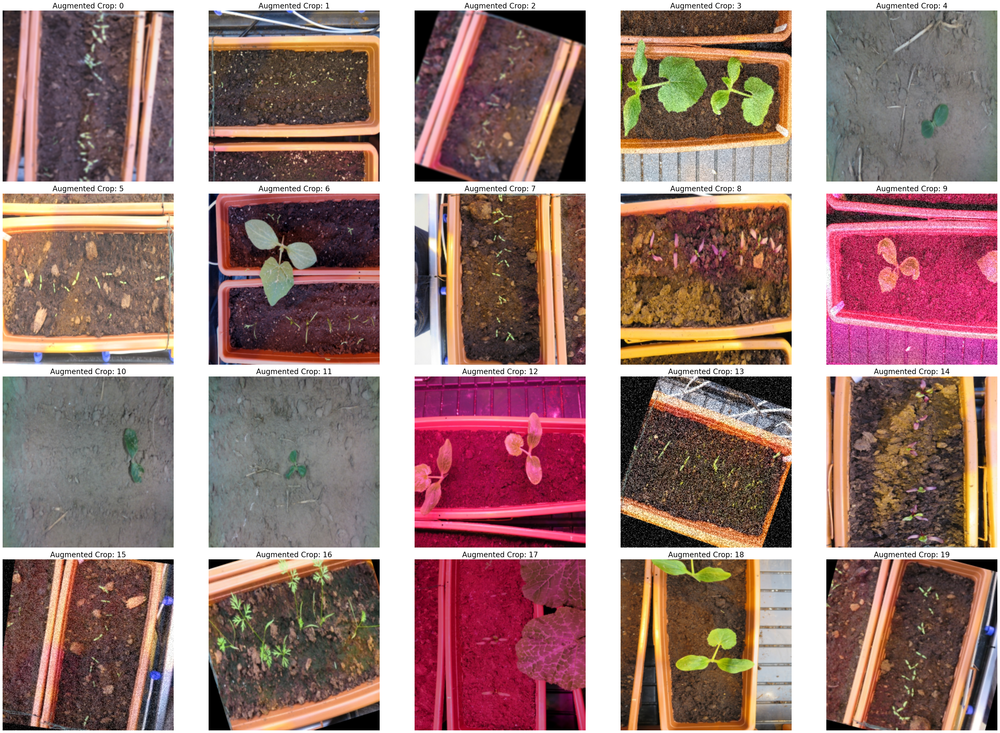

In [25]:
# Augmented crop sample
visualize_augmented_crops(train_crop_aug, n_rows=4, cols=5)

<div align="center">
    <h1>Modeling</h1>
</div>

- I ran more than 18 experiments evaluating different models and dataset combinations
- I will share only the most interesting ones

| Experiment | Dataset | Comments |
| --- | --- | --- |
| **BalancedRandomForestClassifier** |  **LBP + HOG (full) features** | **`sampling ALL`** |
| **BalancedRandomForestClassifier** |  **LBP + HOG (full) features** | **sampling MAJORITY** |
| BalancedRandomForestClassifier |  LBP + HOG (PCA) features | |
| **BalancedRandomForestClassifier** |  **LBP + HOG (PCA) + HSV features** | **`class_weight={"crop": 1, "weed": 0.75}`** |
| PyCaret | LBP + HOG (PCA) + HSV features | Train all available models (14) |
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes** |
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes `Precision` tuned**|
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes Redacted dataset** |
| PyCaret | LBP + HOG (PCA) + HSV + Augmentations | Naive Bayes |
| GaussianNB optimization `var_smoothing` | LBP + HOG (PCA) + HSV + Augmentations | `var_smoothing=0.1` |
| GaussianNB optimization `sample weights` | LBP + HOG (PCA) + HSV + Augmentations | `weed_weight=2.81` |
| GaussianNB optimization `hard sample weights` | LBP + HOG (PCA) + HSV + Augmentations | `hard_weed_weight=3.5`  |
| GaussianNB optimization `probability threshold` | LBP + HOG (PCA) + HSV + Augmentations | `threshold=0.5900` | 
| GaussianNB **grid optmization** | LBP + HOG (PCA) + HSV + Augmentations |  | 

In [26]:
# BalancedRandomForestClassifier (LBP+HOG) - sampling_strategy = all



In [ ]:
# BalancedRandomForestClassifier (LBP + HOG (PCA) + HSV features) - sampling_strategy = MAJORITY



In [28]:
# BalancedRandomForestClassifier - class_weight={"crop": 1, "weed": 0.75}



In [ ]:
# PyCaret (LBP + HOG (PCA) + HSV features) - SMOTE - NB Best algorithm
# Precision crop: (TP/(TP+FP)): 0.3142857142857143


In [29]:
# PyCaret (LBP + HOG (PCA) + HSV features) - SMOTE - NB Best tuned
# Precision crop: (TP/(TP+FP)): 0.321
# Several trade-offs between F1 and Precission

In [30]:
# PyCaret LBP + HOG (PCA) + HSV features Naive Bayes Redacted dataset
# 0.379310


In [31]:
# GaussianNB optimization var_smoothing LBP + HOG (PCA) + HSV + Augmentations
# var_smoothing=0.1


In [ ]:
# GaussianNB optimization sample weights  LBP + HOG (PCA) + HSV + Augmentations 
# weed_weight=2.81


In [ ]:
# GaussianNB optimization hard sample weights LBP + HOG (PCA) + HSV + Augmentations
# hard_weed_weight=3.5


In [32]:
# GaussianNB optimization probability threshold  LBP + HOG (PCA) + HSV + Augmentations
# threshold=0.5900


In [34]:
# GaussianNB grid optmization 	LBP + HOG (PCA) + HSV + Augmentations 	



## 1. Problem definition

**Problem definition**
Classifying crops vs. weeds to enable autonomous herbicide application, focusing on high crop recall to ensure yield safety.

## 2. Dataset overview

**Dataset Overview**
Brief description of the data source and the class imbalance (Few crops vs. many weeds).

## 3. Feature Engineering

**The Fusion Logic**
- HOG (shape)
- LBP (texture)
- HSV (color).

**Dimensionality Reduction**
Show the PCA step. Mention that you reduced HOG features to 800 components to prevent the "Curse of Dimensionality" in Naive Bayes.

**Visualizing Features**
Plot a histogram of one feature (e.g., Hue from HSV) comparing Crops and Weeds to show the professor there is a "correlation" as requested in Step 3 of the assignment.

## 4. Model / Fit (The Optimization)

**Baseline Model**
Run a quick vanilla GaussianNB to show it fails (high False Positives).

**Hyperparameter Grid Search**

- Insert your Grid Search code here!!!
- Display the Heatmap (Smoothing vs. Weed Weight).

Text:
The grid search identifies the optimal balance between statistical feature value smoothing and cost-sensitive weighting.

## 5. Evaluate / Communicate (The "Full" Analysis)

- The Surgical Result: Train the final model with best_params.
- The PR-Curve & Pinned Threshold:
    - Plot the Precision-Recall curve.
    - Explain the extraction of the Pinned Threshold
- Final Confusion Matrix: evaluate(print_cnfm=True)
- Business-Level Metrics: * Translate the matrix into real-world terms: "Our model saves 91.6% of crops while rejecting 85% of weeds."

## 6. Conclusions & Future Work

By fusing HOG, LBP, and HSV features with a cost-sensitive GaussianNB, we achieved an AUC of 0.90.

We enriched the minority samples with transformed images and increased the ratio to X

**Future Work**
- Naive Bayes is a strong baseline, future iterations could explore the BalancedRandomForestClassifier
- PyCaret provides a collection of algorithms to experiment with on the optimized dataset

## References


In [27]:
# Experiment GAUSIAN NB classifier
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the grid
smoothing_grid = np.logspace(-9, 1, 10) # 1e-9 to 10
weight_grid = np.linspace(1.0, 5.0, 10) # 1.0 to 5.0

# Storage for results
auc_results = np.zeros((len(smoothing_grid), len(weight_grid)))

best_auc = 0
best_params = {"smooth": 0, "weight": 0}

print("Running Grid Search...")

for i, s in enumerate(smoothing_grid):
    for j, w in enumerate(weight_grid):
        # Prepare weights
        iter_weights = np.ones(len(y_train))
        iter_weights[hard_weed_indices] = w
        
        # Train and get metrics using your experiment function
        # Using print_cnfm=False to stay fast
        m, _ = experiment_gaussian_nb(X_train, y_train, X_test, y_test, 
                                       var_smoothing=s, 
                                       sample_weight=iter_weights)
        
        auc_results[i, j] = m["AUC score"]
        
        if m["AUC score"] > best_auc:
            best_auc = m["AUC score"]
            best_params = {"smooth": s, "weight": w}

print(f"Optimal found: Smoothing={best_params['smooth']:.2e}, Weight={best_params['weight']:.2f}")

Running Grid Search...


NameError: name 'hard_weed_indices' is not defined

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(auc_results, annot=True, fmt=".3f", 
            xticklabels=[f"{w:.1f}" for w in weight_grid], 
            yticklabels=[f"{s:.1e}" for s in smoothing_grid])
plt.title("Grid Search: AUC Score (Smoothing vs. Weed Weight)")
plt.xlabel("Hard Weed Weight")
plt.ylabel("Var Smoothing")
plt.show()

In [ ]:
# 1. Prepare the final weights based on Grid Search results
final_weights = np.ones(len(y_train))
final_weights[hard_weed_indices] = best_params['weight']

# 2. Initialize and Train the final "Surgical" Model
final_nb_clf = GaussianNB(var_smoothing=best_params['smooth'])
final_nb_clf.fit(X_train, y_train, sample_weight=final_weights)

# 3. Get the Probabilities for the PR-Curve
final_probs = final_nb_clf.predict_proba(X_test)[:, 0] # Column 0 = 'crop'

# 4. Extract the Pinned Threshold from the curve (to save 11/12 crops)b
from sklearn.metrics import precision_recall_curve
precisions, recalls, thresholds = precision_recall_curve(y_test, final_probs, pos_label="crop")

# Find the threshold for ~92% Recall
target_recall = 0.91
idx = np.where(recalls >= target_recall)[0][-1]
pinned_t = thresholds[idx]

# 5. Create Final Binary Predictions
final_preds = ["crop" if p >= pinned_t else "weed" for p in final_probs]

# 6. Run the Final Evaluation
print(f"--- FINAL MODEL PERFORMANCE (Threshold: {pinned_t:.4f}) ---")
results = evaluate(y_test, final_preds, y_probs=final_probs, print_cnfm=True)

In [ ]:
#|export
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import precision_recall_curve

def run_gnb_optimization_and_evaluation(X_train, y_train, X_test, y_test, target_recall=0.91):
    """
    Performs grid search on smoothing and class weights, 
    visualizes the heatmap, and evaluates the final surgical model.
    """
    
    # 1. Identify 'hard weed' indices (Weeds often misclassified as crops)
    # This ensures the function is self-contained
    baseline_gnb = GaussianNB().fit(X_train, y_train)
    baseline_preds = baseline_gnb.predict(X_train)
    # Hard weeds are ground-truth 'weed' but predicted as 'crop'
    hard_weed_indices = np.where((y_train == "weed") & (baseline_preds == "crop"))[0]

    # 2. Define the grid
    smoothing_grid = np.logspace(-9, 1, 10)
    weight_grid = np.linspace(1.0, 5.0, 10)
    auc_results = np.zeros((len(smoothing_grid), len(weight_grid)))

    best_auc = 0
    best_params = {"smooth": 0, "weight": 0}

    print("Running Grid Search...")
    for i, s in enumerate(smoothing_grid):
        for j, w in enumerate(weight_grid):
            iter_weights = np.ones(len(y_train))
            iter_weights[hard_weed_indices] = w
            
            # Using your existing experiment function
            m, _, _ = experiment_gaussian_nb(X_train, y_train, X_test, y_test, 
                                           var_smoothing=s, 
                                           sample_weight=iter_weights)
            
            auc_results[i, j] = m["AUC score"]
            if m["AUC score"] > best_auc:
                best_auc = m["AUC score"]
                best_params = {"smooth": s, "weight": w}

    # 3. Plot Heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(auc_results, annot=True, fmt=".3f", 
                xticklabels=[f"{w:.1f}" for w in weight_grid], 
                yticklabels=[f"{s:.1e}" for s in smoothing_grid],
                cmap="YlGnBu")
    plt.title("Grid Search: AUC Score (Smoothing vs. Weed Weight)")
    plt.xlabel("Hard Weed Weight")
    plt.ylabel("Var Smoothing")
    plt.show()

    print(f"Optimal found: Smoothing={best_params['smooth']:.2e}, Weight={best_params['weight']:.2f}")

    # 4. Final "Surgical" Model Training
    final_weights = np.ones(len(y_train))
    final_weights[hard_weed_indices] = best_params['weight']
    
    final_nb_clf = GaussianNB(var_smoothing=best_params['smooth'])
    final_nb_clf.fit(X_train, y_train, sample_weight=final_weights)
    
    # Probabilities for 'crop' (Column 0)
    final_probs = final_nb_clf.predict_proba(X_test)[:, 0]

    # 5. Threshold Pinning for High Recall
    precisions, recalls, thresholds = precision_recall_curve(y_test, final_probs, pos_label="crop")
    
    # Find the threshold for target_recall
    idx = np.where(recalls >= target_recall)[0][-1]
    pinned_t = thresholds[idx]

    # 6. Final Evaluation
    final_preds = ["crop" if p >= pinned_t else "weed" for p in final_probs]
    print(f"\n--- FINAL MODEL PERFORMANCE (Pinned Threshold: {pinned_t:.4f}) ---")
    results = evaluate(y_test, final_preds, y_probs=final_probs, print_cnfm=True)
    
    return final_nb_clf, pinned_t

Dataset citation:

```text
@article{SUDARS2020105833,
  title = {Dataset of annotated food crops and weed images for robotic computer vision control},
  journal = {Data in Brief},
  volume = {31},
  pages = {105833},
  year = {2020},
  issn = {2352-3409},
  doi = {https://doi.org/10.1016/j.dib.2020.105833},
  url = {https://www.sciencedirect.com/science/article/pii/S2352340920307277},
  author = {Kaspars Sudars and Janis Jasko and Ivars Namatevs and Liva Ozola and Niks Badaukis},
}
```

https://datasetninja.com/dataset-of-annotated-food-crops-and-weed-images#citation